# Self-Driving Car Engineer Nanodegree(Term 1)

## Advanced Lane Findings (Udacity CarND Project 4)

### The goals / steps of this project are the following:
- Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
- Apply a distortion correction to raw images.
- Use color transforms, gradients, etc., to create a thresholded binary image.
- Apply a perspective transform to rectify binary image ("birds-eye view").
- Detect lane pixels and fit to find the lane boundary.
- Determine the curvature of the lane and vehicle position with respect to center.
- Warp the detected lane boundaries back onto the original image.
- Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob,os
%matplotlib inline

## 1. Camera calibration

### Finding Corners

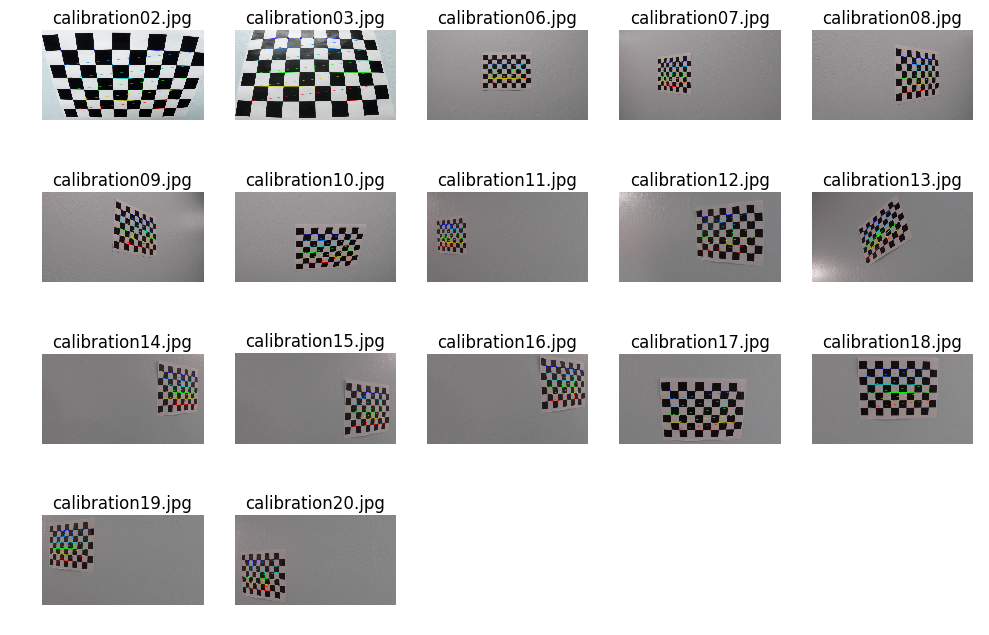

In [2]:
import matplotlib.pyplot as plt
import numpy as np
import cv2
import glob
%matplotlib inline

nx = 9 # the number of inside corners in x
ny = 6 # the number of inside corners in y

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints =[] # 2d points in image plane.

# prepare object points
objp = np.zeros((nx * ny,3),np.float32)
objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2)

# Make a list of calibration images
images = glob.glob('camera_cal/calibration*.jpg')
count = 0
plt.figure(figsize=(12, 8))

for fname in images:
    img = cv2.imread(fname)
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
    # If found, draw corners
    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img_cor = cv2.drawChessboardCorners(img, (nx,ny), corners, ret)
        plt.subplot(4, 5, count+1)
        plt.axis('off')
        plt.title(fname.split('/')[-1])
        plt.imshow(img_cor)
        
        write_name = './corners_found/corners'+ fname.split('/')[-1] +'.jpg'
        cv2.imwrite(write_name, img)
        count += 1

### Undistort the image

We get all of the object points and image points, so we will use them to calibrate our camera.

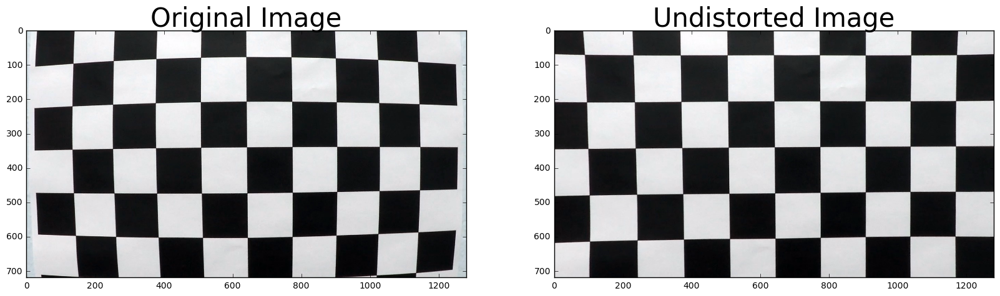

In [3]:
import pickle

# Test undistortion on an image
img = cv2.imread('./camera_cal/calibration01.jpg')
img_size = (img.shape[1], img.shape[0])

# Do camera calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)


dst = cv2.undistort(img, mtx, dist, None, mtx)
cv2.imwrite('./output_images/calibration1_undist.jpg',dst)

# Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump( dist_pickle, open( "./output_images/camera_mtx_dist.p", "wb" ) )
#dst = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)
# Visualize undistortion
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(dst)
ax2.set_title('Undistorted Image', fontsize=30)

We finish the camera calibration.

## 2. Apply a Distortion Correction

In [4]:
def undistort(img):
    mtx = dist_pickle['mtx']
    dist = dist_pickle['dist']
    return cv2.undistort(img, mtx, dist, None, mtx)

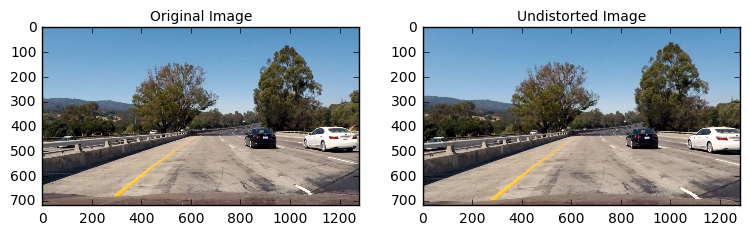

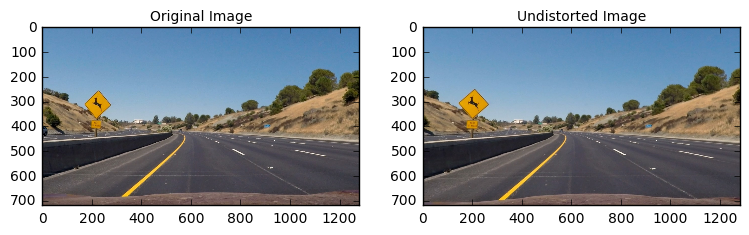

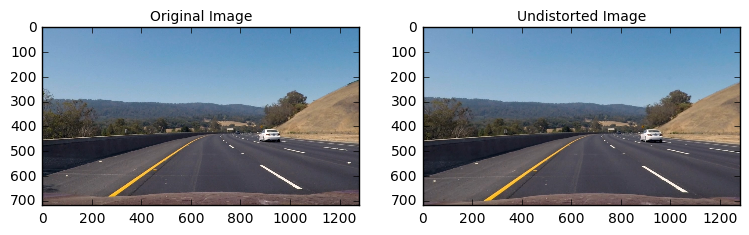

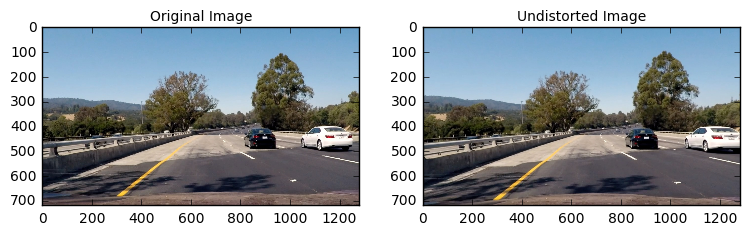

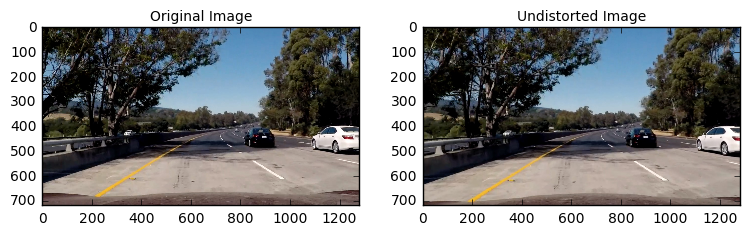

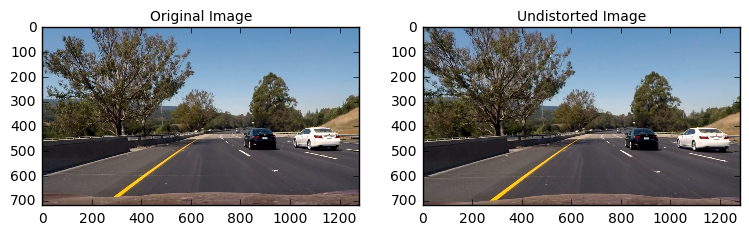

In [5]:
images = glob.glob('test_images/test*.jpg')
for image in images:
    img = cv2.imread(image)
    undist = undistort(img)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(9,6))
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Image', fontsize=10)
    ax2.imshow(cv2.cvtColor(undist, cv2.COLOR_BGR2RGB))
    ax2.set_title('Undistorted Image', fontsize=10)
    plt.savefig('output_images/undistorted.png'.format(None), bbox_inches="tight")

## 3. Create a thresholded binary image

We want to detect the lanes on the roads, but don't want to detect the trees or other vehicles in this prject. Fortunately, lane lines color is always white/yellow and high contrast between roads and lanes.

In this section, we apply some threshold to pick only yellow and white elements.

### Applying sobel operator

In [6]:
def sobel_x(img, threshold_MIN=20, threshold_MAX=255):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0)
    abs_sobel = np.absolute(sobel)
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= threshold_MIN) & (scaled_sobel <= threshold_MAX)] = 1
    return binary_output

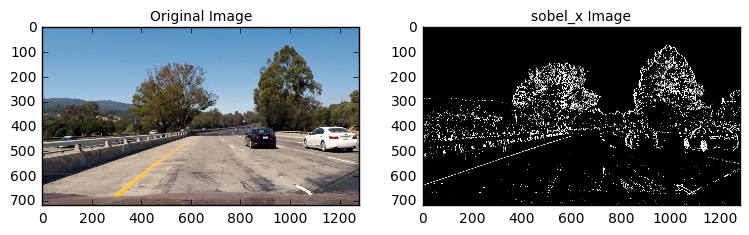

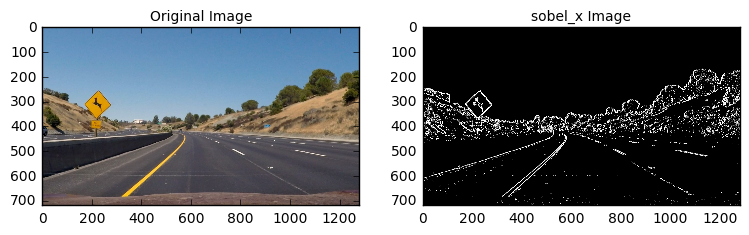

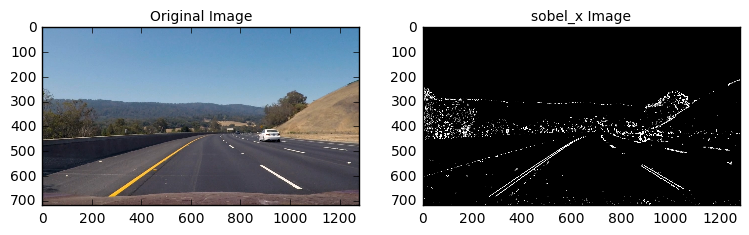

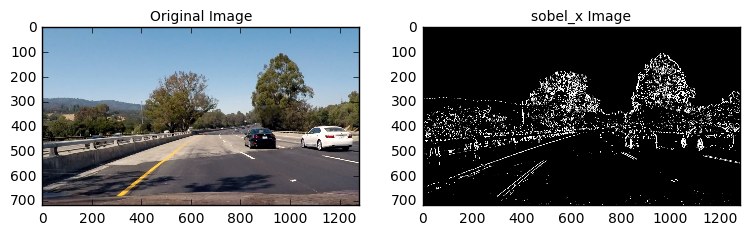

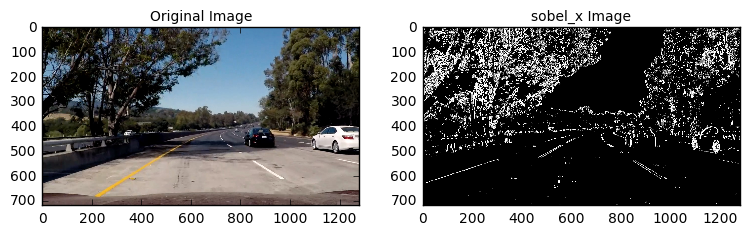

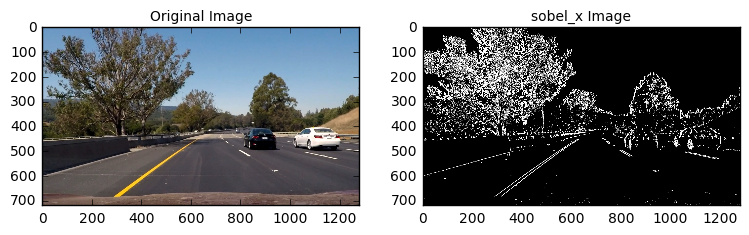

In [7]:
images = glob.glob('test_images/test*.jpg')
for image in images:
    img = cv2.imread(image)
    sobelx = sobel_x(img)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(9,6))
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Image', fontsize=10)
    ax2.imshow(sobelx, cmap='gray')
    ax2.set_title('sobel_x Image', fontsize=10)
    plt.savefig('output_images/sobel_x.png'.format(None), bbox_inches="tight")

In [8]:
def sobel_y(img, threshold_MIN=35, threshold_MAX=255):  
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1)
    abs_sobel = np.absolute(sobel)
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= threshold_MIN) & (scaled_sobel <= threshold_MAX)] = 1
    return binary_output

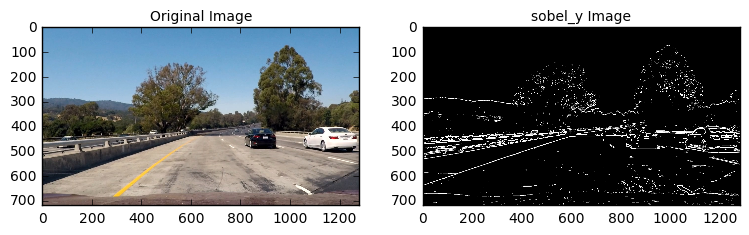

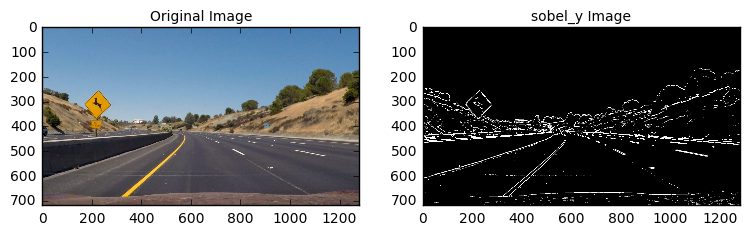

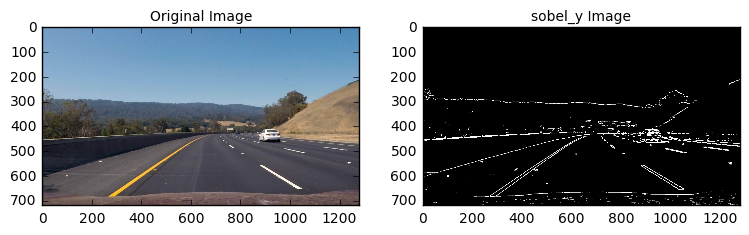

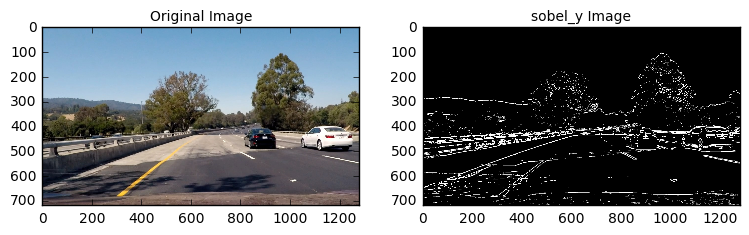

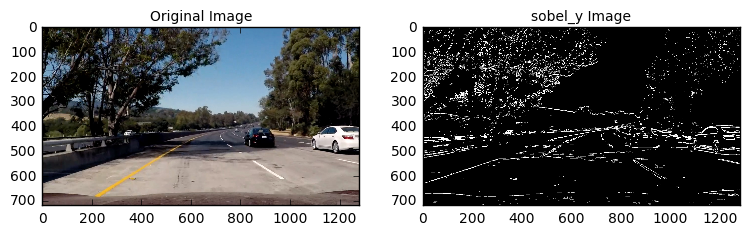

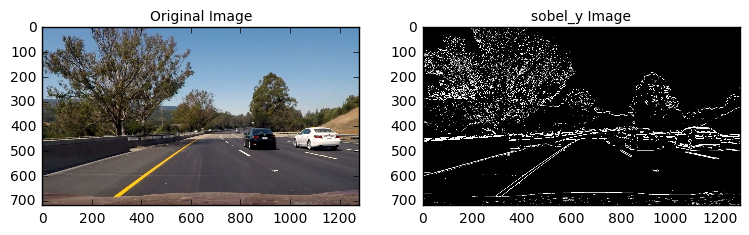

In [9]:
images = glob.glob('test_images/test*.jpg')
for image in images:
    img = cv2.imread(image)
    sobely = sobel_y(img)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(9,6))
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Image', fontsize=10)
    ax2.imshow(sobely, cmap='gray')
    ax2.set_title('sobel_y Image', fontsize=10)
    plt.savefig('output_images/sobel_y.png'.format(None), bbox_inches="tight")

### Magnitude of the gradient

In [10]:
def gradient_magnitude(img, sobel_kernel=9, mag_threshold=(50, 255)):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    sobel_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobel_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    gradmag = np.sqrt(sobel_x**2 + sobel_y**2)
    gradmag = np.uint8(255*gradmag/np.max(gradmag))
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_threshold[0]) & (gradmag <= mag_threshold[1])] = 1
    return binary_output

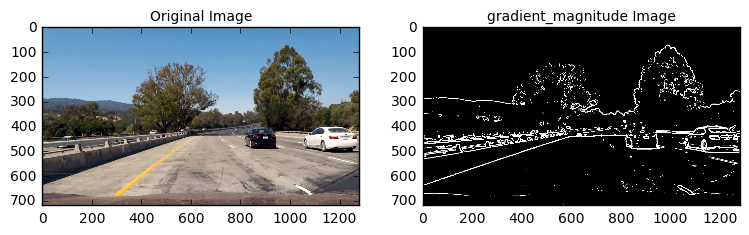

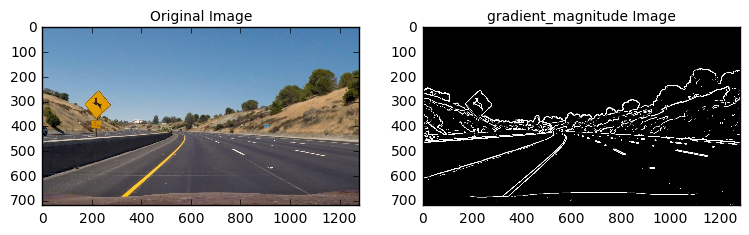

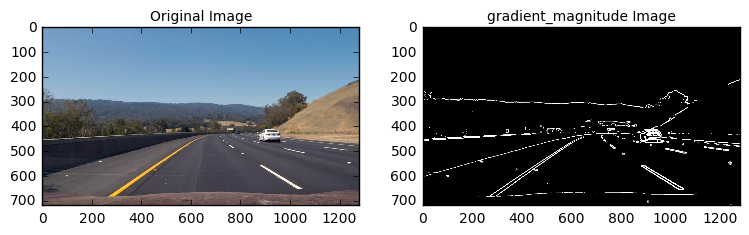

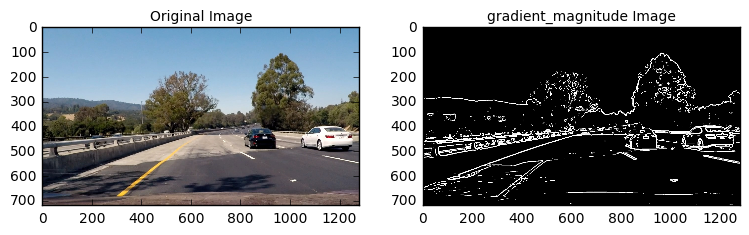

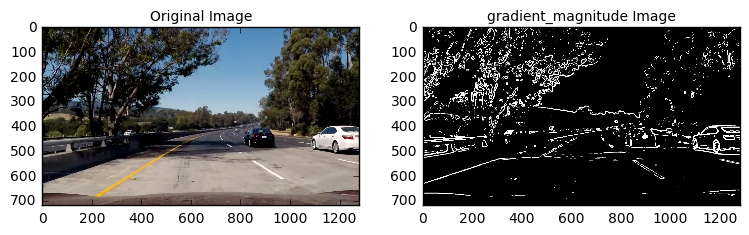

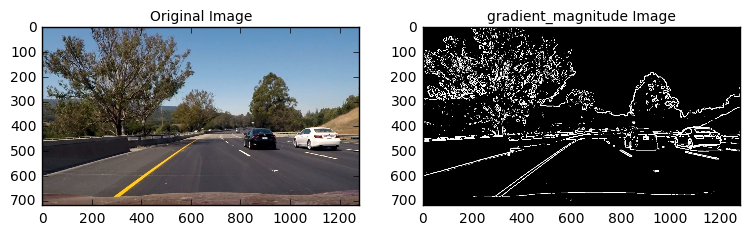

In [11]:
images = glob.glob('test_images/test*.jpg')
for image in images:
    img = cv2.imread(image)
    gradient_m = gradient_magnitude(img)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(9,6))
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Image', fontsize=10)
    ax2.imshow(gradient_m, cmap='gray')
    ax2.set_title('gradient_magnitude Image', fontsize=10)
    plt.savefig('output_images/gradient_magnitude.png'.format(None), bbox_inches="tight")

### Direction of the gradient

In [12]:
def gradient_direction(img, sobel_kernel=15, thresh=(0.6, 1.3)):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    sobel_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobel_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    abs_grad_dir = np.arctan2(np.absolute(sobel_y), np.absolute(sobel_x))
    binary_output =  np.zeros_like(abs_grad_dir)
    binary_output[(abs_grad_dir >= thresh[0]) & (abs_grad_dir <= thresh[1])] = 1
    return binary_output

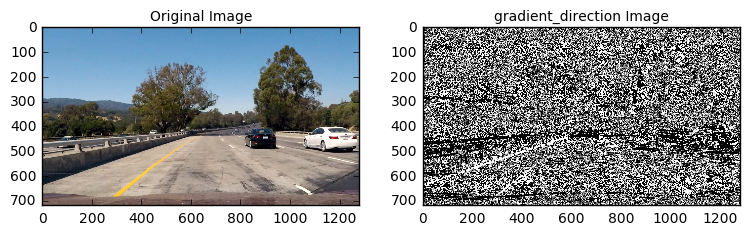

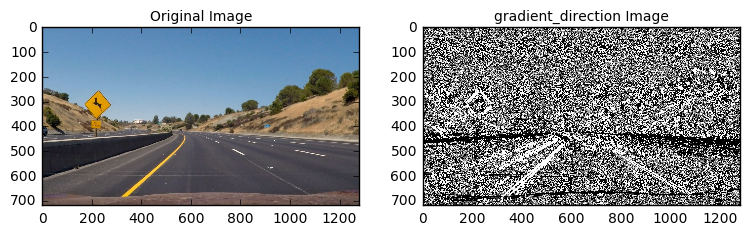

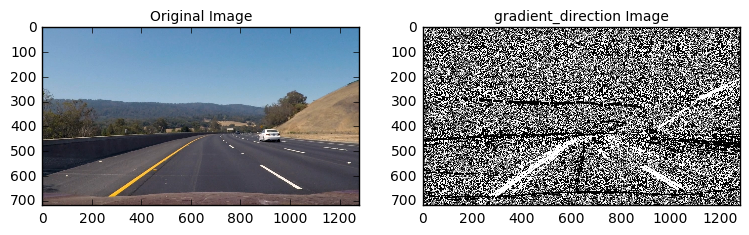

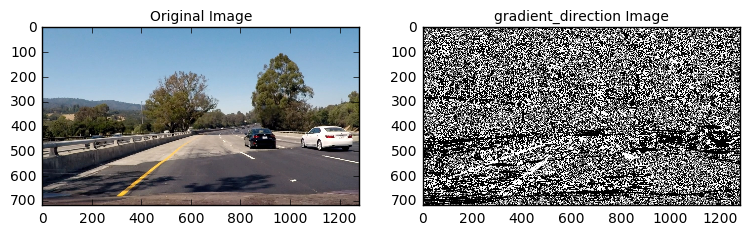

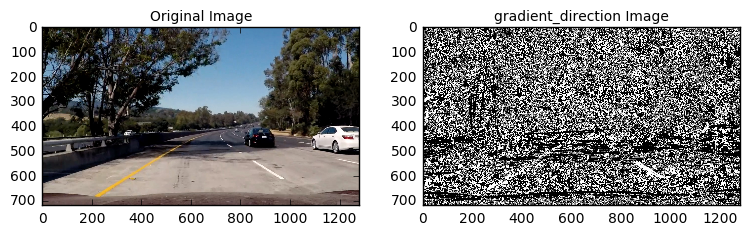

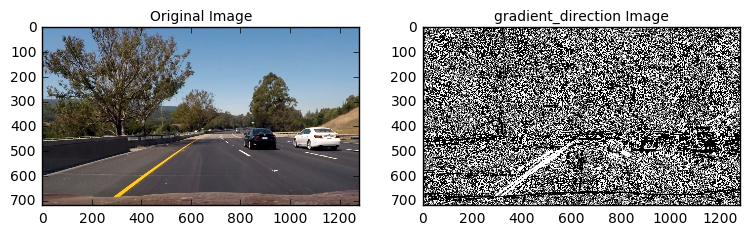

In [13]:
images = glob.glob('test_images/test*.jpg')
for image in images:
    img = cv2.imread(image)
    gradient_d = gradient_direction(img)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(9,6))
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Image', fontsize=10)
    ax2.imshow(gradient_d, cmap='gray')
    ax2.set_title('gradient_direction Image', fontsize=10)
    plt.savefig('output_images/gradient_direction.png'.format(None), bbox_inches="tight")

### Color Threshold

In [14]:
def color_thresholds(img, HLS_s_threshold=(90, 255), HSV_v_threshold=(120,255)):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel > HLS_s_threshold[0]) & (s_channel <= HLS_s_threshold[1])] = 1
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    v_channel = hsv[:,:,2]
    v_binary = np.zeros_like(v_channel)
    v_binary[(v_channel > HSV_v_threshold[0]) & (v_channel <= HSV_v_threshold[1])] = 1  
    binary_output = np.zeros_like(s_channel)
    binary_output[(s_binary == 1) & (v_binary == 1)] = 1
    return binary_output

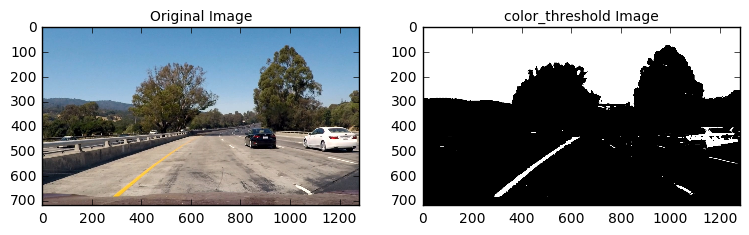

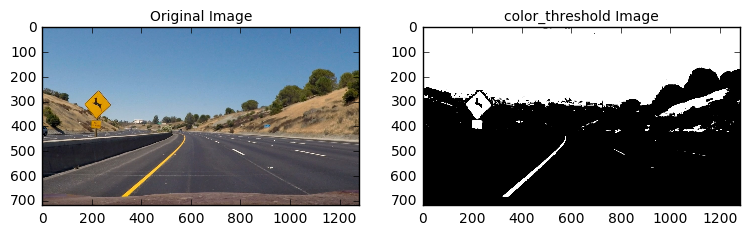

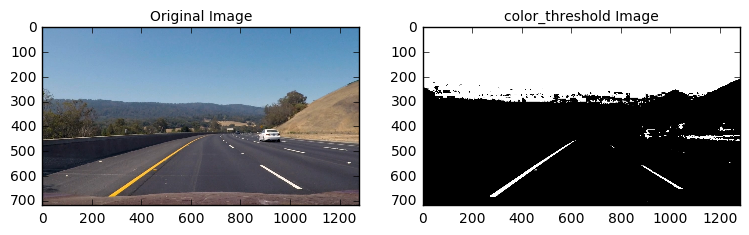

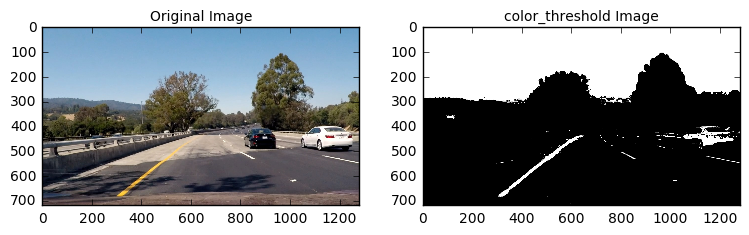

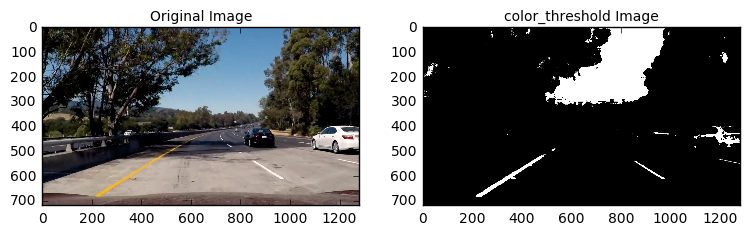

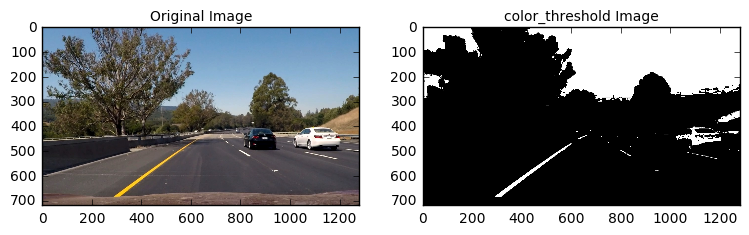

In [15]:
images = glob.glob('test_images/test*.jpg')
for image in images:
    img = cv2.imread(image)
    color_t = color_thresholds(img)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(9,6))
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Image', fontsize=10)
    ax2.imshow(color_t, cmap='gray')
    ax2.set_title('color_threshold Image', fontsize=10)
    plt.savefig('output_images/color_threshold.png'.format(None), bbox_inches="tight")

### Combine threshold

In [16]:
def combined_thresholds(img):
    img = undistort(img)
    binary_x = sobel_x(img)
    binary_y = sobel_y(img)
    mag = gradient_magnitude(img)
    direct = gradient_direction(img)
    color = color_thresholds(img)
    img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    binary_output = np.zeros_like(img)
    binary_output[(binary_x == 1) & (binary_y == 1) & (mag == 1) | (color == 1) | (mag == 1) & (direct == 1)] = 1
    return binary_output

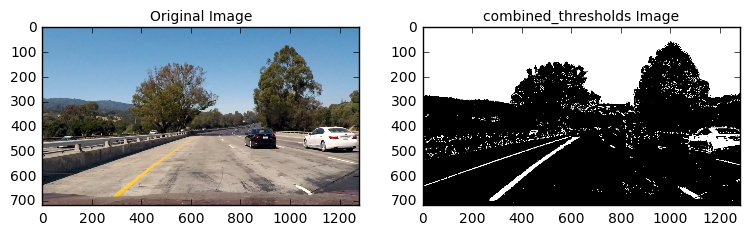

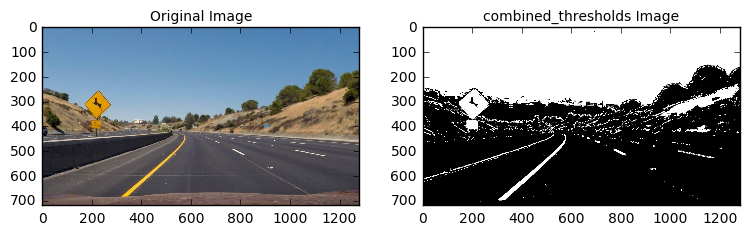

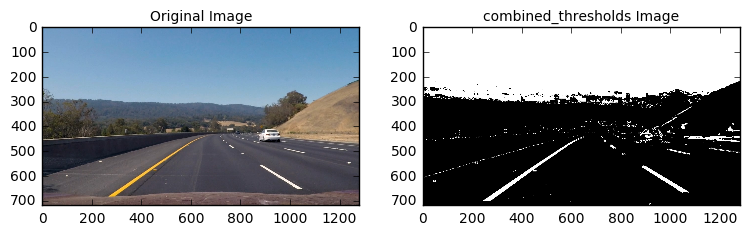

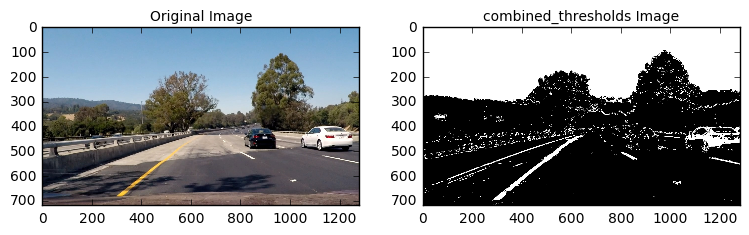

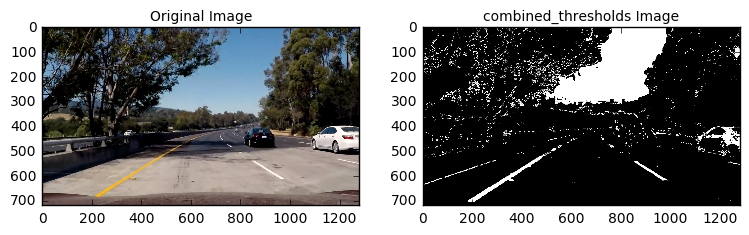

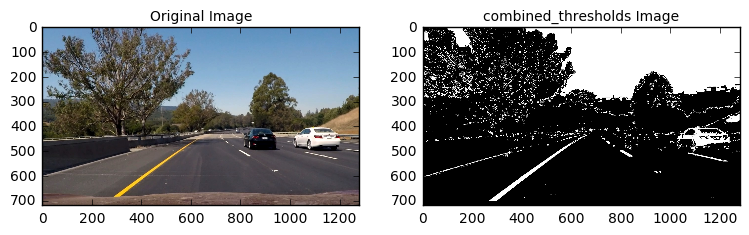

In [17]:
images = glob.glob('test_images/test*.jpg')
for image in images:
    img = cv2.imread(image)
    combined_t = combined_thresholds(img)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(9,6))
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Image', fontsize=10)
    ax2.imshow(combined_t, cmap='gray')
    ax2.set_title('combined_thresholds Image', fontsize=10)
    plt.savefig('output_images/combined_thresholds.png'.format(None), bbox_inches="tight")

## 4. Apply a perspective transform

In [19]:
def birds_eye(img):
    offset = 0
    img_size = (img.shape[1], img.shape[0])
    
    src = np.float32([[(img_size[0] / 2) - 60, img_size[1] / 2 + 100],
                    [((img_size[0] / 6) - 10), img_size[1]],
                    [(img_size[0] * 5 / 6) + 90, img_size[1]],
                      [(img_size[0] / 2 + 60), img_size[1] / 2 + 100]])
    
    
    dst = np.float32([[(img_size[0] / 4), 0],
                    [(img_size[0] / 4), img_size[1]],
                    [(img_size[0] * 3 / 4), img_size[1]],
                    [(img_size[0] * 3 / 4), 0]])
    
    
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)

    # Warp the image using OpenCV warpPerspective()
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    return warped, M, Minv

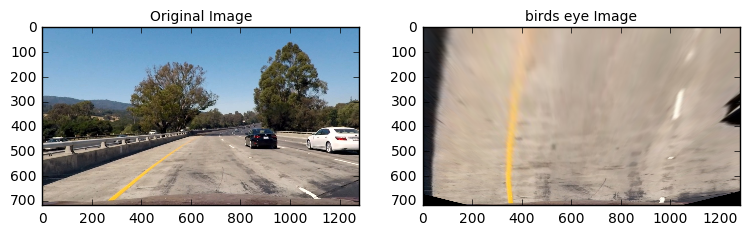

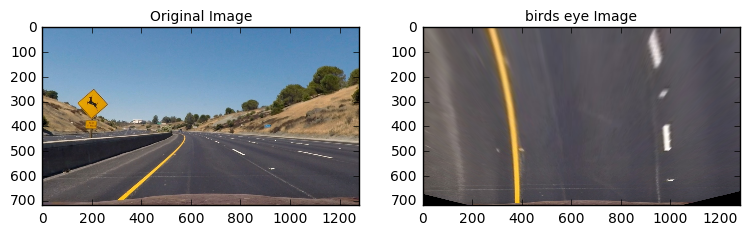

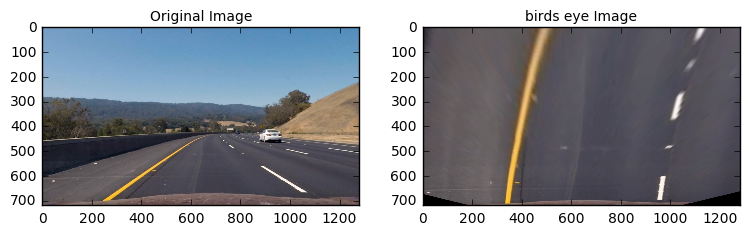

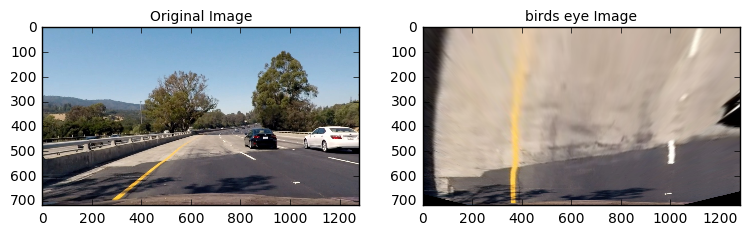

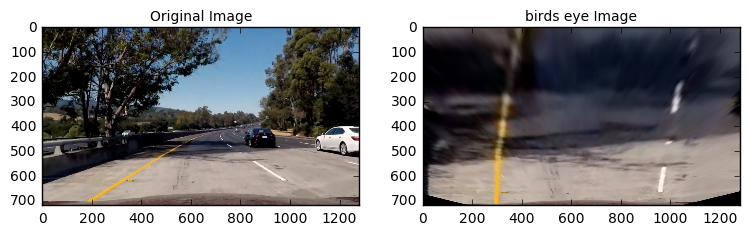

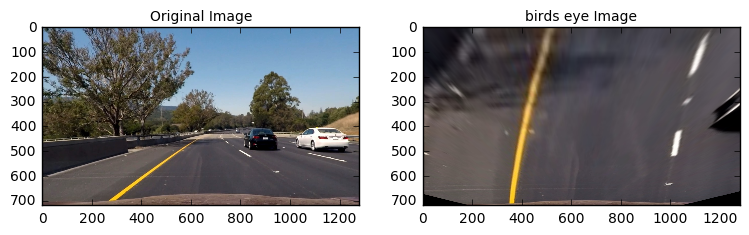

In [20]:
images = glob.glob('test_images/test*.jpg')
for image in images:
    img = cv2.imread(image)
    img = undistort(img)
    warped, M, Minv = birds_eye(img)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(9,6))
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Image', fontsize=10)
    ax2.imshow(cv2.cvtColor(warped, cv2.COLOR_BGR2RGB))
    ax2.set_title('birds eye Image', fontsize=10)
    plt.savefig('output_images/birds_eye.png'.format(None), bbox_inches="tight")

Warped Binaly image

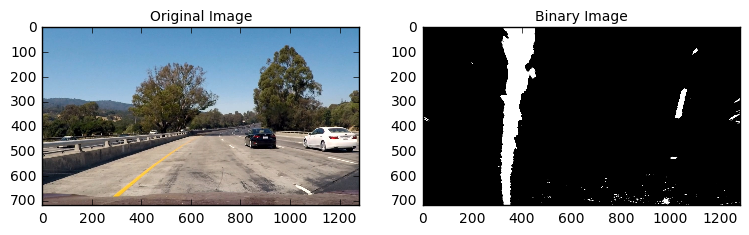

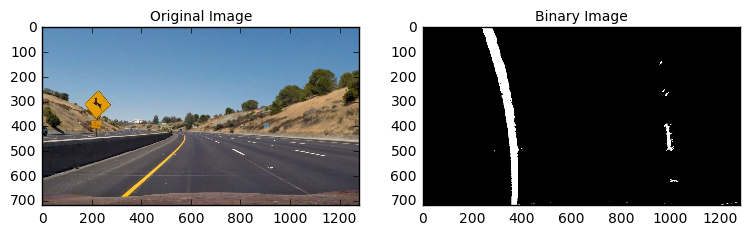

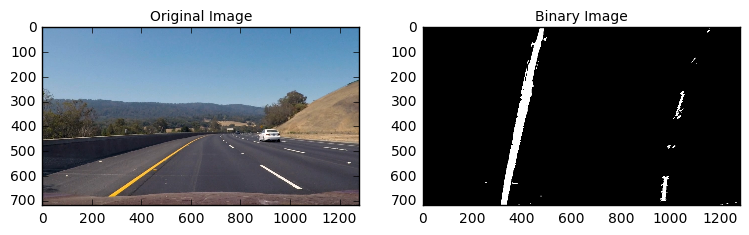

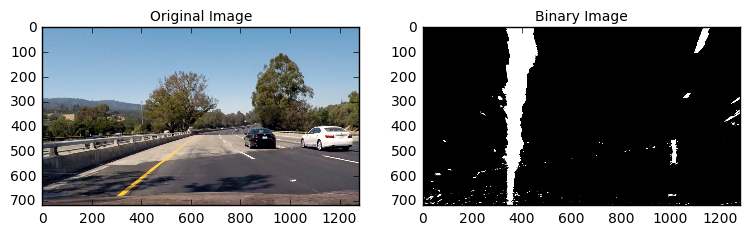

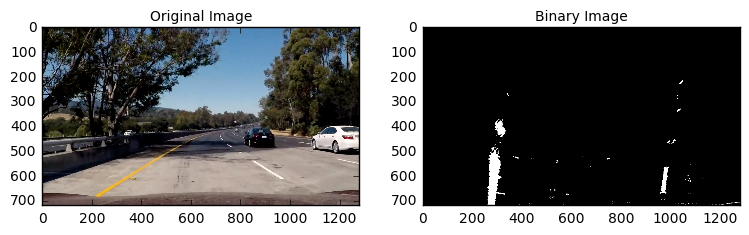

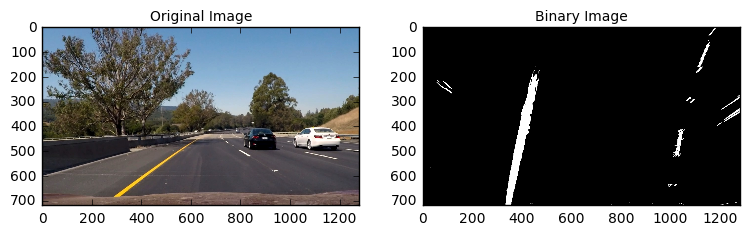

In [21]:
images = glob.glob('test_images/test*.jpg')
for image in images:
    img = cv2.imread(image)
    warped, M, Minv = birds_eye(img)
    new_img = combined_thresholds(warped)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(9,6))
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Image', fontsize=10)
    ax2.imshow(new_img, cmap='gray')
    ax2.set_title('Binary Image', fontsize=10)
    plt.savefig('output_images/Binary.png'.format(None), bbox_inches="tight")

## 5. Detect lane pixels and fit to find the lane boundary.

### Line Finding Method: Peaks in a Histogram

//anaconda/envs/py35/lib/python3.5/site-packages/ipykernel/__main__.py:7: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


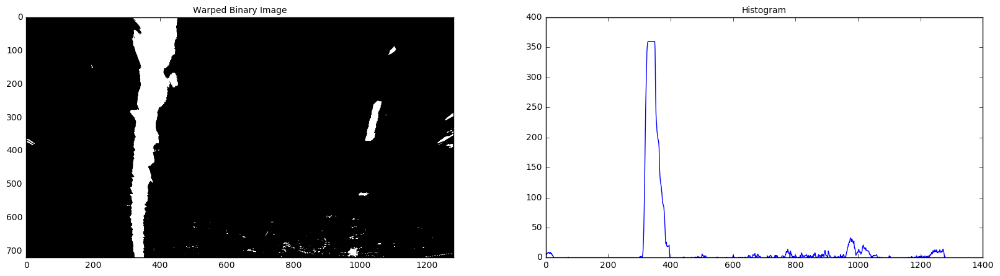

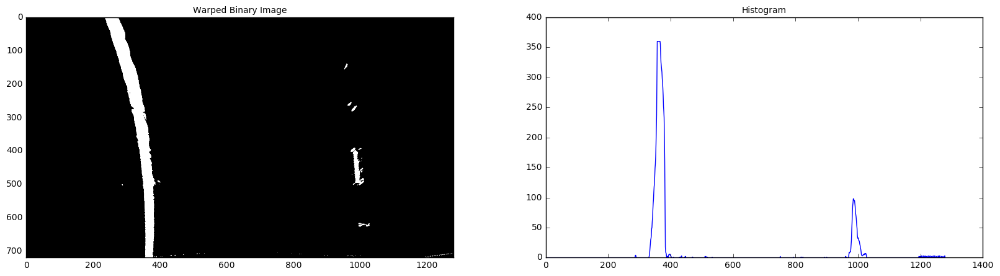

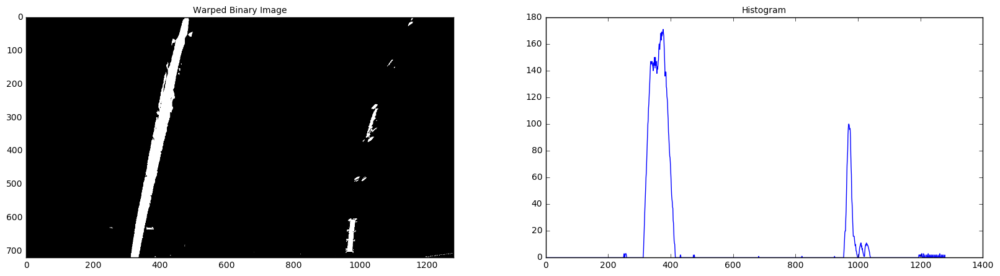

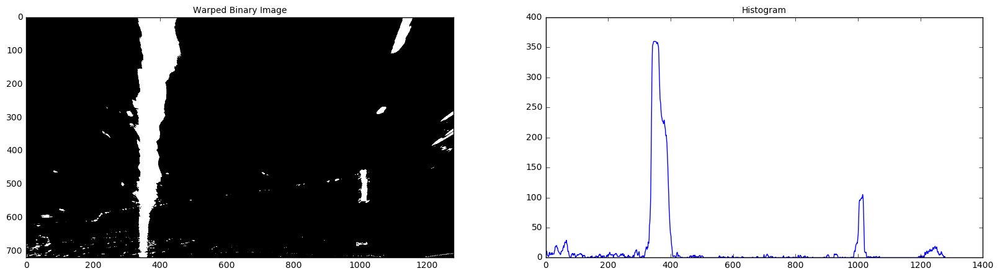

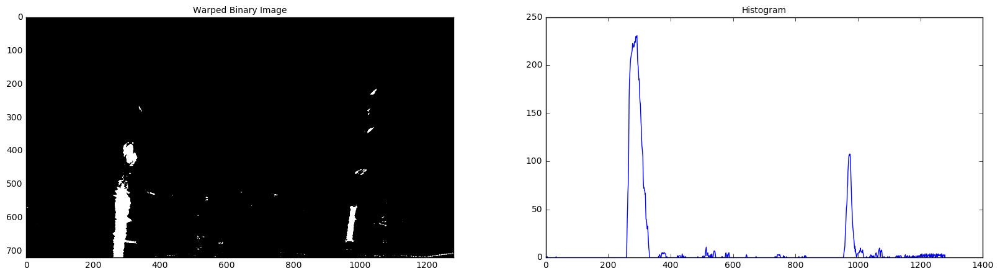

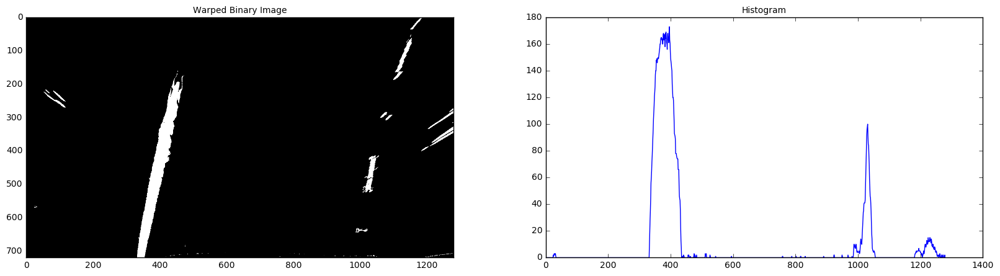

In [22]:
images = glob.glob('test_images/test*.jpg')

for img in images:
    img = cv2.imread(img)
    warped, M, Minv = birds_eye(img)
    new_img = combined_thresholds(warped)
    histogram = np.sum(new_img[new_img.shape[0]/2:,:], axis=0)
    # Visualize thresholds
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,5))
    ax1.imshow(new_img, cmap='gray')
    ax1.set_title('Warped Binary Image', fontsize=10)
    plt.plot(histogram)
    ax2.set_title('Histogram', fontsize=10)

### Implement Sliding Windows and Fit a Polynomial

In [23]:
def findlines(binary_warped):
    histogram = np.sum(binary_warped[binary_warped.shape[0]/2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    
    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    
    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
    
    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)
    
    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 
    
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    
    
    return out_img, ploty, left_fitx, right_fitx, left_fit, right_fit, leftx, rightx, leftx_base, rightx_base

### Visualization

//anaconda/envs/py35/lib/python3.5/site-packages/ipykernel/__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app


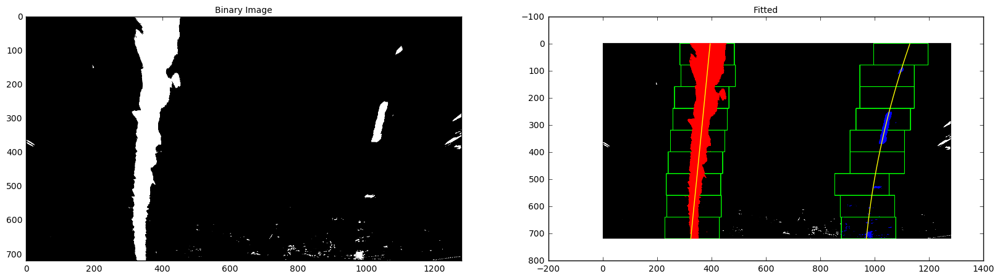

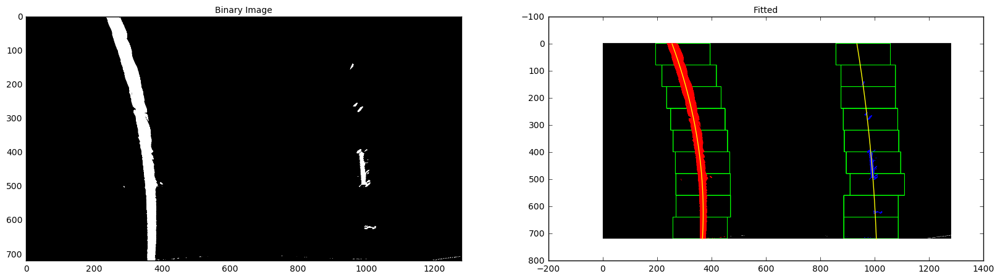

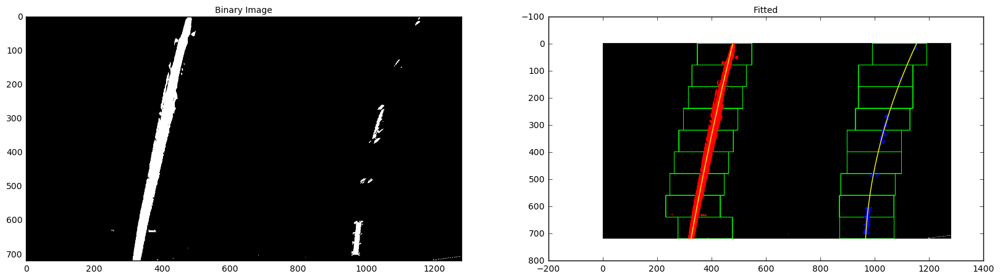

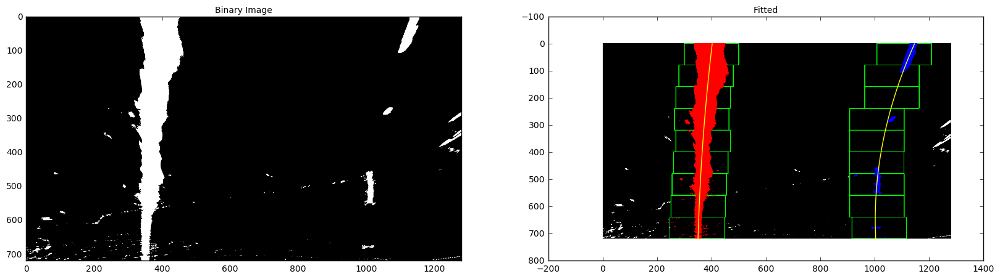

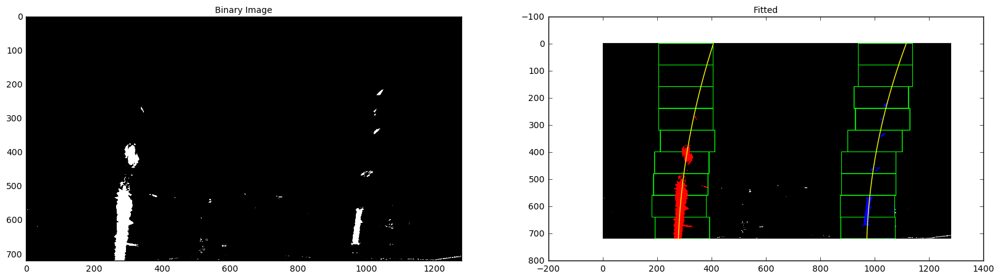

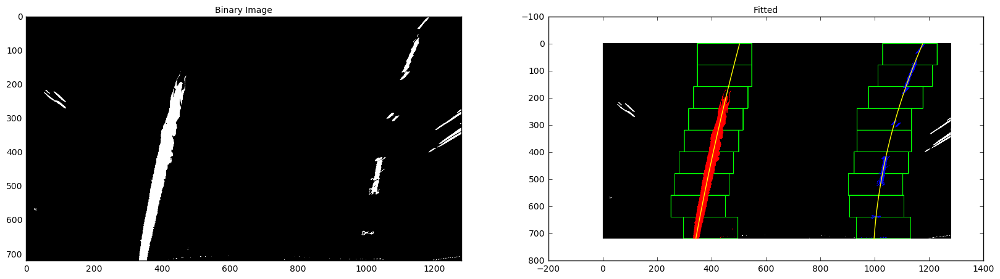

In [24]:
images = glob.glob('test_images/test*.jpg')

for img in images:
    img = cv2.imread(img)
    warped, M, Minv = birds_eye(img)
    new_img = combined_thresholds(warped)
    windows_img, ploty, left_fitx, right_fitx, left_fit, right_fit, leftx, rightx, leftx_base, rightx_base = findlines(new_img)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(new_img, cmap='gray')
    ax1.set_title('Binary Image', fontsize=10)
    ax2.imshow(windows_img, cmap='gray')
    ax2.set_title('Fitted', fontsize=10)
    ax2.plot(left_fitx, ploty, color='yellow')
    ax2.plot(right_fitx, ploty, color='yellow')
    plt.savefig('output_images/finding_lines.png'.format(None), bbox_inches="tight")

### Skip the sliding windows step once you know where the lines are

In [25]:
def shaded_lanes(binary_warped, left_fit, right_fit):
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  
    
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    
    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))
    
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,200, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,200, 0))
    out_img = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    return out_img, ploty, left_fitx, right_fitx, left_fit, right_fit


### Visualize the result

//anaconda/envs/py35/lib/python3.5/site-packages/ipykernel/__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app


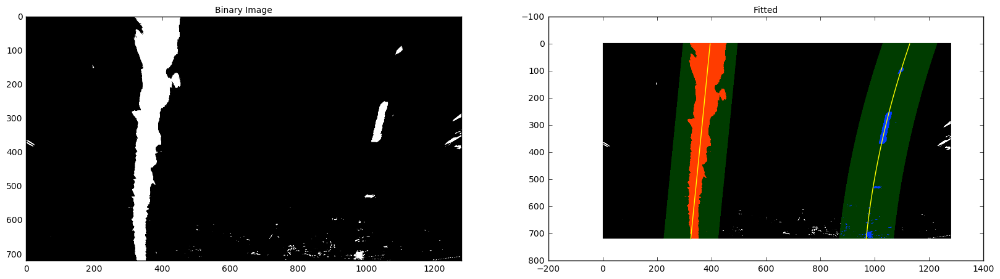

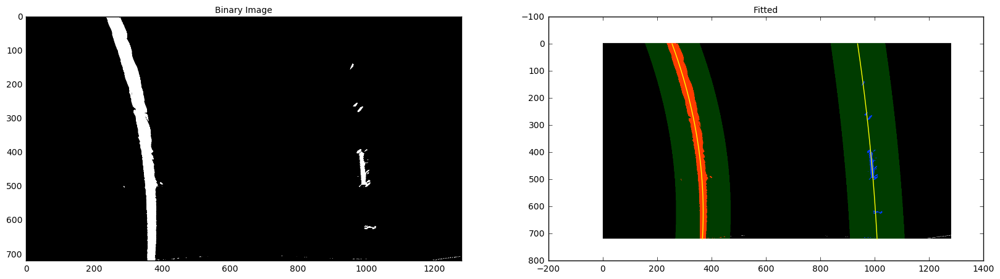

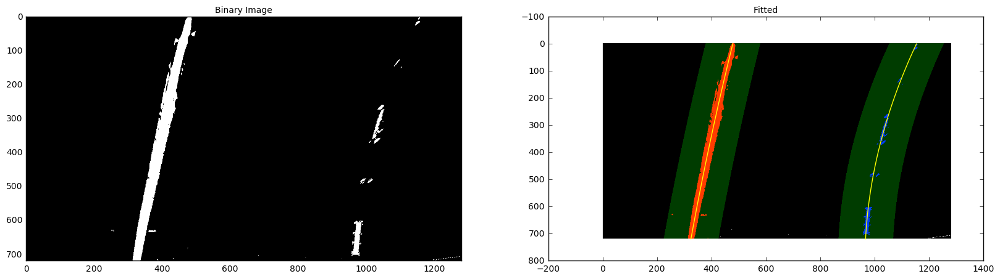

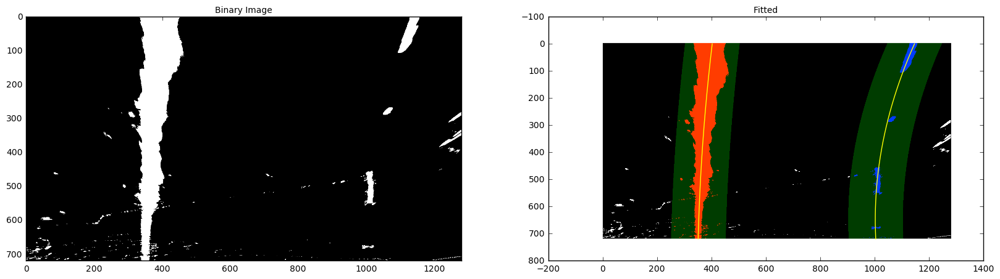

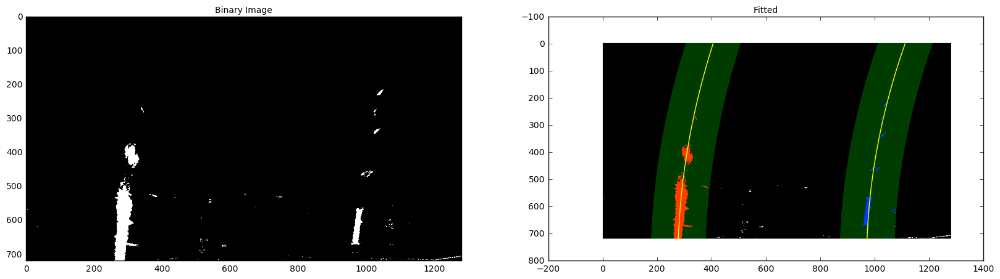

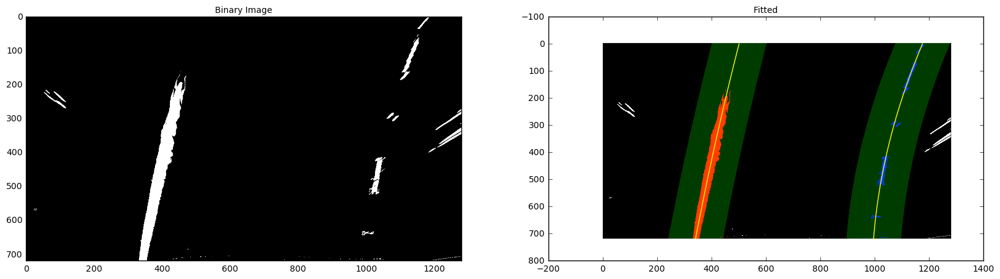

In [27]:
images = glob.glob('test_images/test*.jpg')

for img in images:
    img = cv2.imread(img)
    warped, M, Minv = birds_eye(img)
    new_img = combined_thresholds(warped)
    windows_img, ploty, left_fitx, right_fitx, left_fit, right_fit, leftx, rightx, leftx_base, rightx_base = findlines(new_img)
    shades_img, ploty, left_fitx, right_fitx, left_fit, right_fit = shaded_lanes(new_img, left_fit, right_fit)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(new_img, cmap='gray')
    ax1.set_title('Binary Image', fontsize=10)
    ax2.imshow(shades_img, cmap='gray')
    ax2.set_title('Fitted', fontsize=10)
    ax2.plot(left_fitx, ploty, color='yellow')
    ax2.plot(right_fitx, ploty, color='yellow')
    plt.savefig('output_images/shaded_lanes.png'.format(None), bbox_inches="tight")

### Another Line Finding Method: Sliding Window Search

In [28]:
def window_mask(width, height, img_ref, center,level):
    output = np.zeros_like(img_ref)
    output[int(img_ref.shape[0]-(level+1)*height):int(img_ref.shape[0]-level*height),max(0,int(center-width/2)):min(int(center+width/2),img_ref.shape[1])] = 1
    return output

def find_window_centroids(image, window_width, window_height, margin):
    
    window_centroids = [] # Store the (left,right) window centroid positions per level
    window = np.ones(window_width) # Create our window template that we will use for convolutions
    
    # First find the two starting positions for the left and right lane by using np.sum to get the vertical image slice
    # and then np.convolve the vertical image slice with the window template 
    
    # Sum quarter bottom of image to get slice, could use a different ratio
    l_sum = np.sum(image[int(3*image.shape[0]/4):,:int(image.shape[1]/2)], axis=0)
    l_center = np.argmax(np.convolve(window,l_sum))-window_width/2
    r_sum = np.sum(image[int(3*image.shape[0]/4):,int(image.shape[1]/2):], axis=0)
    r_center = np.argmax(np.convolve(window,r_sum))-window_width/2+int(image.shape[1]/2)
    
    # Add what we found for the first layer
    window_centroids.append((l_center,r_center))
    
    # Go through each layer looking for max pixel locations
    for level in range(1,(int)(image.shape[0]/window_height)):
        # convolve the window into the vertical slice of the image
        image_layer = np.sum(image[int(image.shape[0]-(level+1)*window_height):int(image.shape[0]-level*window_height),:], axis=0)
        conv_signal = np.convolve(window, image_layer)
        # Find the best left centroid by using past left center as a reference
        # Use window_width/2 as offset because convolution signal reference is at right side of window, not center of window
        offset = window_width/2
        l_min_index = int(max(l_center+offset-margin,0))
        l_max_index = int(min(l_center+offset+margin,image.shape[1]))
        l_center = np.argmax(conv_signal[l_min_index:l_max_index])+l_min_index-offset
        # Find the best right centroid by using past right center as a reference
        r_min_index = int(max(r_center+offset-margin,0))
        r_max_index = int(min(r_center+offset+margin,image.shape[1]))
        r_center = np.argmax(conv_signal[r_min_index:r_max_index])+r_min_index-offset
        # Add what we found for that layer
        window_centroids.append((l_center,r_center))
    
    if len(window_centroids) > 0:
        # Points used to draw all the left and right windows
        l_points = np.zeros_like(image)
        r_points = np.zeros_like(image)
        # Go through each level and draw the windows
        
        for level in range(0,len(window_centroids)):
            # Window_mask is a function to draw window areas
            l_mask = window_mask(window_width,window_height,image,window_centroids[level][0],level)
            r_mask = window_mask(window_width,window_height,image,window_centroids[level][1],level)
            # Add graphic points from window mask here to total pixels found 
            l_points[(l_points == 255) | ((l_mask == 1) ) ] = 255
            r_points[(r_points == 255) | ((r_mask == 1) ) ] = 255
        
        # Draw the results
        template = np.array(r_points+l_points,np.uint8) # add both left and right window pixels together
        zero_channel = np.zeros_like(template) # create a zero color channle 
        template = np.array(cv2.merge((zero_channel,template,zero_channel)),np.uint8) # make window pixels green
        warpage = np.array(cv2.merge((image,image,image)),np.uint8) # making the original road pixels 3 color channels
        output = cv2.addWeighted(warpage, 1, template, 0.5, 0.0) # overlay the orignal road image with window results
        # If no window centers found, just display orginal road image
    else:
        output = np.array(cv2.merge((image,image,image)),np.uint8)
    
    return window_centroids, output

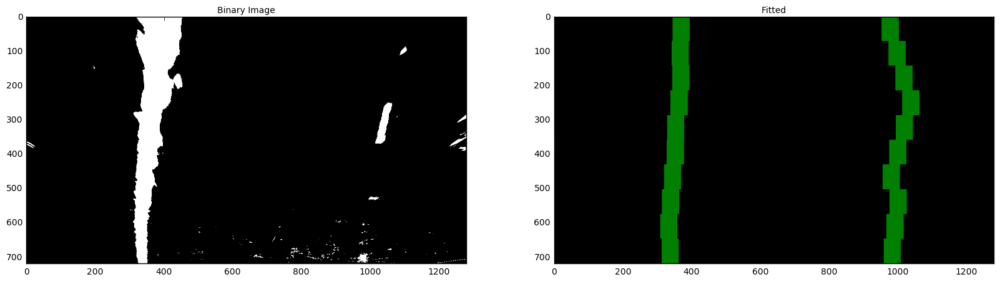

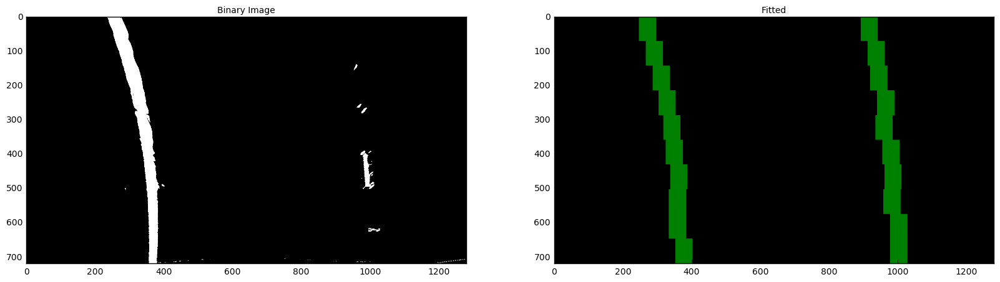

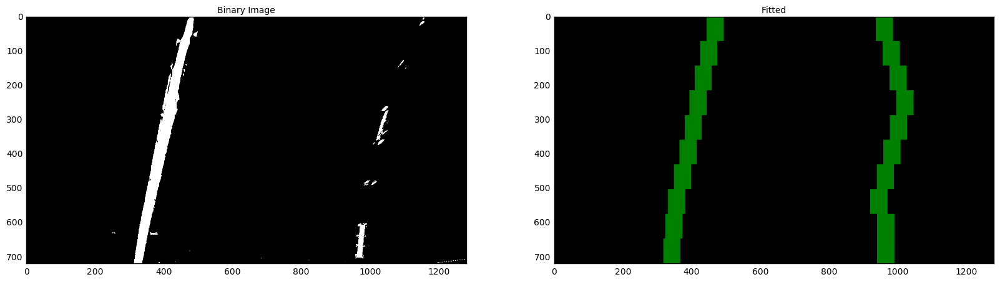

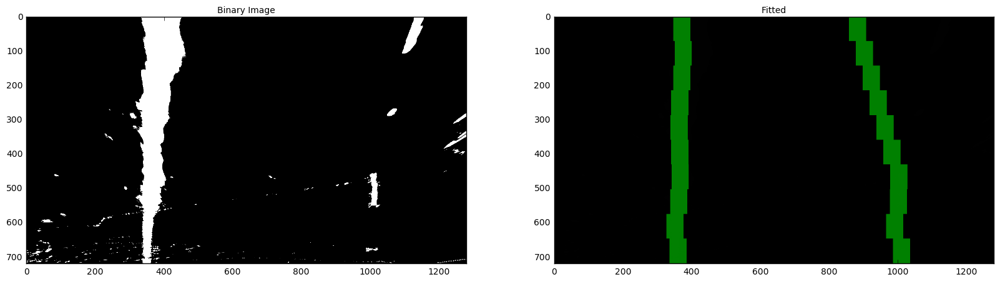

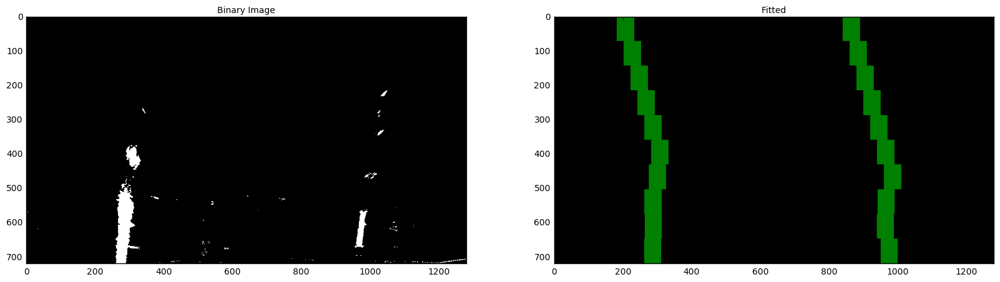

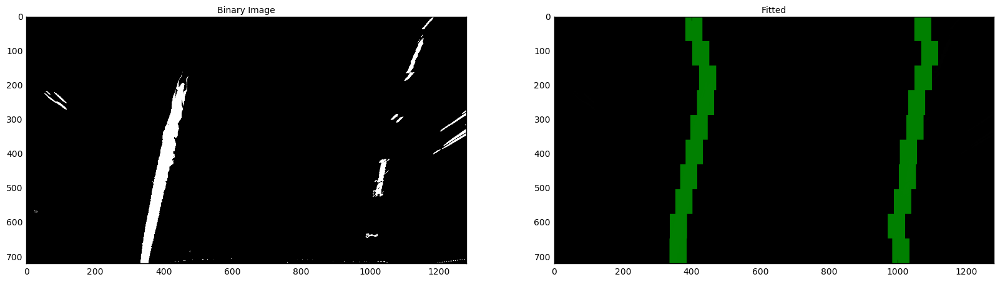

In [29]:
# window settings
window_width = 50 
window_height = 72 # Break image into 10 vertical layers since image height is 720
margin = 20 # How much to slide left and right for searching

images = glob.glob('test_images/test*.jpg')

for img in images:
    img = cv2.imread(img)
    warped, M, Minv = birds_eye(img)
    new_img = combined_thresholds(warped)
    window_centroids, output = find_window_centroids(new_img, window_width, window_height, margin)

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(new_img, cmap='gray')
    ax1.set_title('Binary Image', fontsize=10)
    ax2.imshow(output, cmap='gray')
    ax2.set_title('Fitted', fontsize=10)
    plt.savefig('output_images/window_search.png'.format(None), bbox_inches="tight")


## 6. Determine the curvature of the lane and vehicle position with respect to center.

In [30]:
def calculateCurvature(left_fitx, right_fitx, ploty):
    leftx = left_fitx
    rightx = right_fitx
    # Fit a second order polynomial to pixel positions in each lane line
    left_fit = np.polyfit(ploty, leftx, 2)
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fit = np.polyfit(ploty, rightx, 2)
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
  
    y_eval = np.max(ploty)
    left_curverad = ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
    right_curverad = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])

    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/600 # meters per pixel in y dimension
    xm_per_pix = 3.7/540 # meters per pixel in x dimension

    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(ploty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, rightx*xm_per_pix, 2)
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    # Now our radius of curvature is in meters
    #print(left_curverad, 'm', right_curverad, 'm')
    
    return left_curverad, right_curverad

//anaconda/envs/py35/lib/python3.5/site-packages/ipykernel/__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app


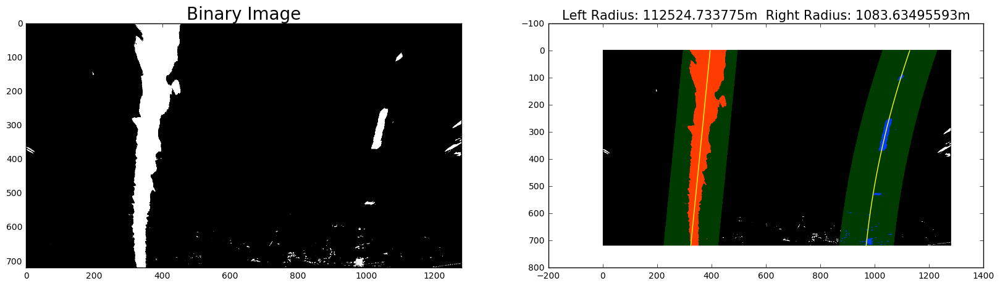

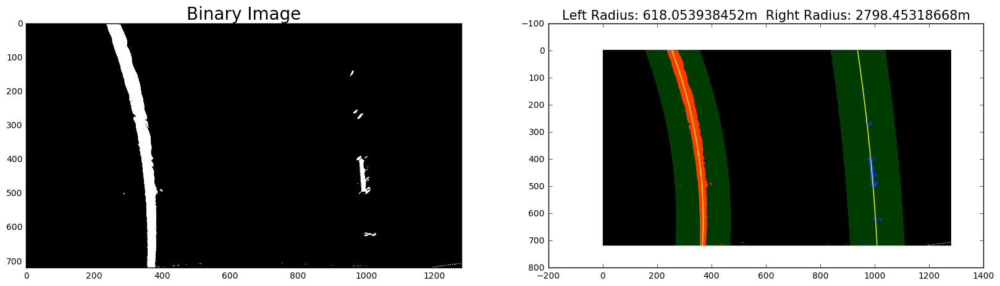

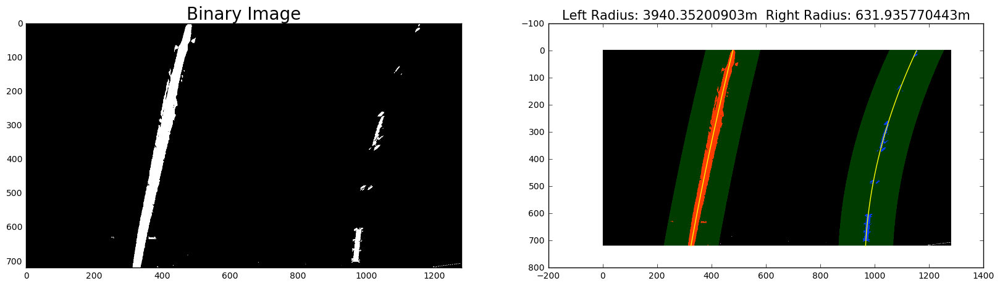

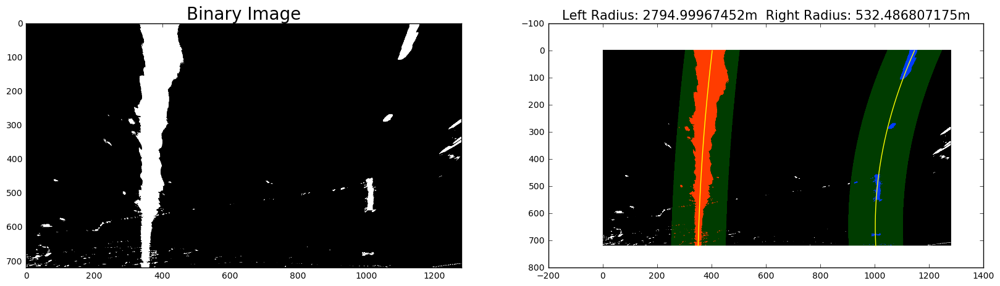

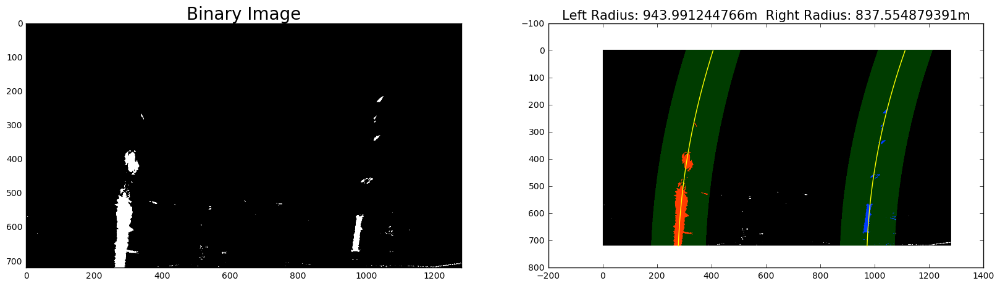

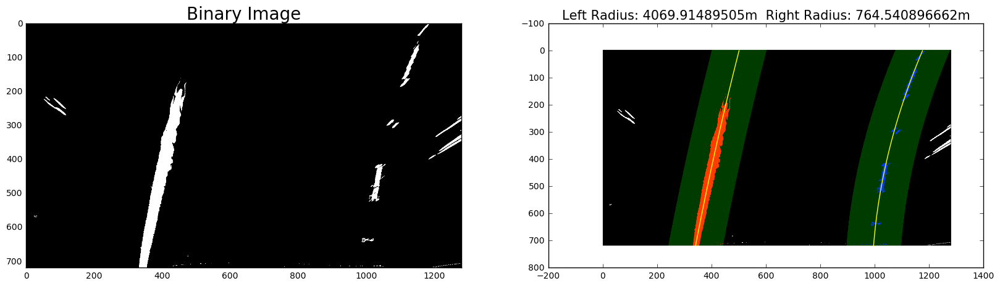

In [31]:
for img in images:
    img = cv2.imread(img)
    warped, M, Minv = birds_eye(img)
    new_img = combined_thresholds(warped)
    windows_img, ploty, left_fitx, right_fitx, left_fit, right_fit, leftx, rightx, leftx_base, rightx_base = findlines(new_img)
    shades_img, ploty, left_fitx, right_fitx, left_fit, right_fit = shaded_lanes(new_img, left_fit, right_fit)
    left_curverad, right_curverad = calculateCurvature(left_fitx, right_fitx, ploty)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(new_img, cmap='gray')
    ax1.set_title('Binary Image', fontsize=20)
    ax2.imshow(shades_img, cmap='gray')
    ax2.set_title('Left Radius: ' + str(left_curverad) + 'm  ' + 'Right Radius: ' + str(right_curverad) + 'm', fontsize=15)
    ax2.plot(left_fitx, ploty, color='yellow')
    ax2.plot(right_fitx, ploty, color='yellow')
    plt.savefig('output_images/curvature.png'.format(None), bbox_inches="tight")

In [43]:
def draw_lines(img_shape, warped, Minv, ploty, left_fitx, right_fitx):
    warp_zero = np.zeros_like(warped[:,:,1]).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255,0)) 
    newwarp = cv2.warpPerspective(color_warp, Minv, (color_warp.shape[1], color_warp.shape[0]))
    out_img = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    return out_img

//anaconda/envs/py35/lib/python3.5/site-packages/ipykernel/__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app


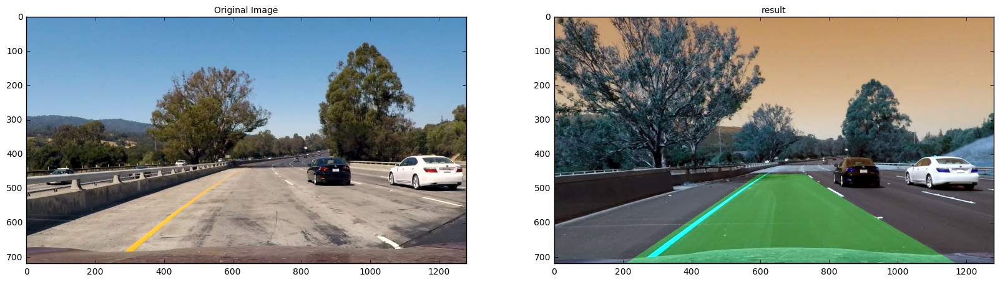

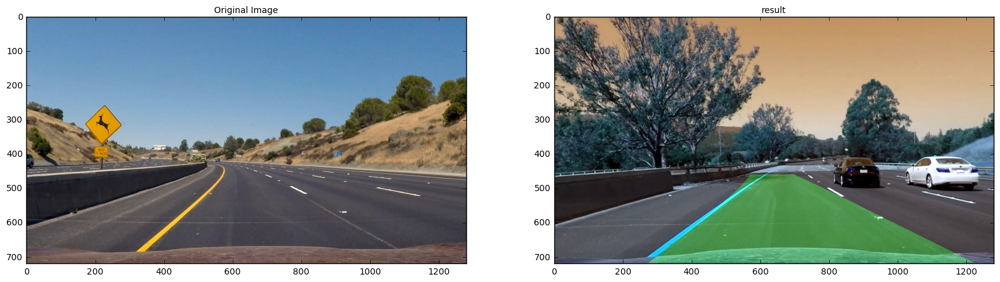

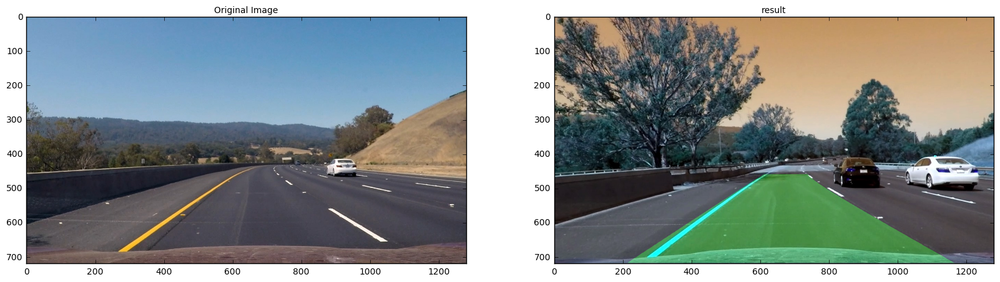

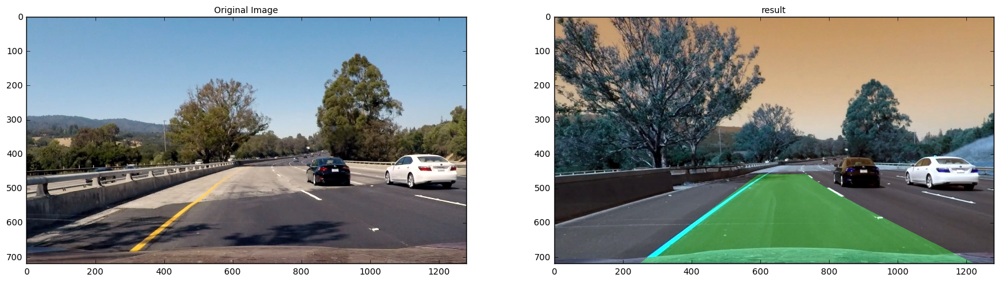

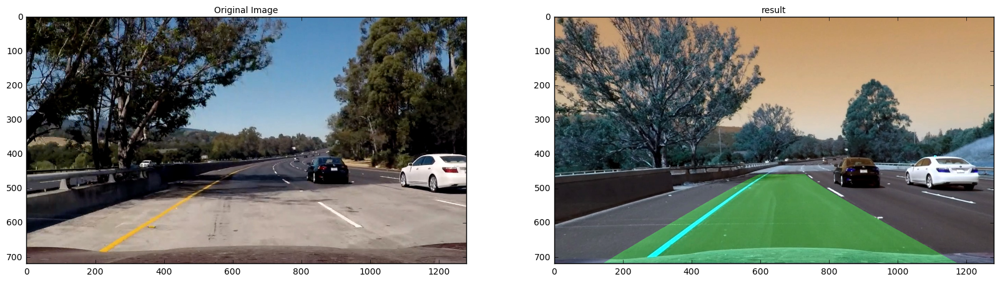

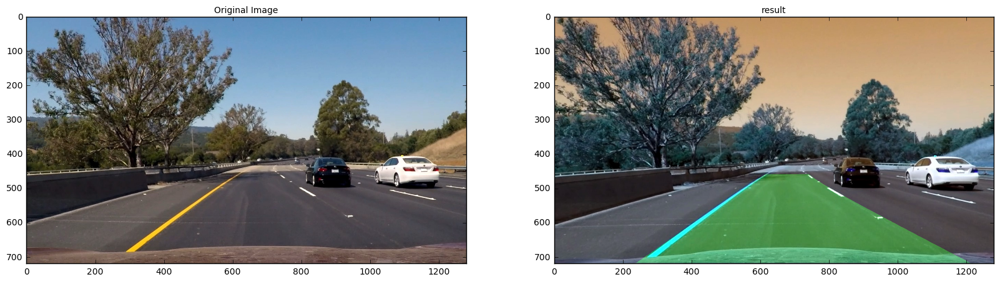

In [44]:
images = glob.glob('test_images/test*.jpg')

for img in images:
    img = cv2.imread(img)
    warped, M, Minv = birds_eye(img)
    new_img = combined_thresholds(warped)
    windows_img, ploty, left_fitx, right_fitx, left_fit, right_fit, leftx, rightx, leftx_base, rightx_base = findlines(new_img)
    #shades_img, ploty, left_fitx, right_fitx, left_fit, right_fit = shaded_lanes(new_img, left_fit, right_fit)
    result = draw_lines(new_img, warped, Minv, ploty, left_fitx, right_fitx)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Image', fontsize=10)
    ax2.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))
    ax2.set_title('result', fontsize=10)
    plt.savefig('output_images/draw_lines.png'.format(None), bbox_inches="tight")

In [54]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        self.num = 0
        self.detected = False  
        self.recent_xfits = [] 
        self.bestx = None
        self.best__xfit = None
        self.current_fit_coeffs = [np.array([False])]
        self.radius_of_curvature = None
        self.line_base_position = None
        self.diffs = np.array([0,0,0], dtype='float') 
        self.allx = None  
        self.ally = None

In [53]:
def annotion(img, left_curverad, right_curverad):
    font = cv2.FONT_HERSHEY_COMPLEX_SMALL
    cv2.putText(img, 'Left Radius of Curvature: {0:6f} meters'.format(left_curverad), (10,30), font, 1, (255,255,255), 2)
    cv2.putText(img, 'Right Radius of Curvature: {0:6f} meters'.format(right_curverad),(10,60), font, 1, (255,255,255), 2)

In [49]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML

right = Line()
left = Line()

right.num = 0
left.num = 0
right.detected = False
left.detected = False


def process_image(image):
        
    undist = undistort(img)
    warped, M, Minv = birds_eye(img)
    new_img = combined_thresholds(warped)
      
    if(left.detected == False):
        windows_img, ploty, left_fitx, right_fitx, left_fit, right_fit, leftx, rightx, leftx_base, rightx_base = findlines(new_img)
        left.detected = True
        right.detected = True
    else:
        shades_img, ploty, left_fitx, right_fitx, left_fit, right_fit = shaded_lanes(new_img, left.current_fit,right.current_fit)
        
    left_curverad, right_curverad = calculateCurvature(left_fitx, right_fitx, ploty)
    left.radius_of_curvature = left_curverad
    right.radius_of_curvature = right_curverad
    curve = (left_curverad + right_curverad)/2
    out_img = draw_lines(img_shape, warped, Minv, ploty, left_fitx, right_fitx)
    
    
    left.current_fit = left_fit
    right.current_fit = right_fit
    
    result = cv2.addWeighted(image, 1, warped, 0.3, 0) 
    plt.close('all')

    cv2.putText(result, "Car position: {:4.2f}m".format(found_center), (460, 100), cv2.FONT_HERSHEY_PLAIN, fontScale=2.5,
                        thickness=5, color=(255, 255, 255))
    cv2.putText(result, "Curvature: {:4.2f}m".format(curve), (460, 200), cv2.FONT_HERSHEY_PLAIN, fontScale=2.5,
                        thickness=5, color=(255, 255, 255))
    plt.imshow(result)
    plt.savefig('output_images/Result - text.png')
    plt.close('all')
    return result

In [51]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML
project_output = 'project_output.mp4'
clip2 = VideoFileClip('project_video.mp4')
project_clip = clip2.fl_image(video_pipeline)
%time project_clip.write_videofile(project_output, audio=False)

TypeError: bad argument type for built-in operation